In [1]:
# Scanpy Clustering Plotting

# Written 02/04/2025
# Run with:
    # python /private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/pub_scipts/04022025_scanpy_plot_projected_umap.py \
    #    -d /private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/scanpy_objects/bulk_adata.h5ad \
    #    -r /private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/data/atlas/myeloid_cho_et_al_2020/allnew20210215_circulation.combined.indep_harmony.h5ad \
    #    -o /private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/figures/blood_atlas \
    #    -a "subclustering" \
    #    --mem 1024

import scanpy as sc
import pandas as pd
import numpy as np
import resource
import argparse
import os
from scipy.spatial import cKDTree
import matplotlib.pyplot as plt
from scipy.stats import hypergeom
import anndata as ad
import scanpy.external as sce
from scipy.stats import percentileofscore
import bbknn

bulk_adata_path ="/private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/scanpy_objects/bulk_adata.h5ad"
ref_adata_path="/private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/data/atlas/myeloid_cho_et_al_2020/allnew20210215_circulation.combined.indep_harmony.h5ad"
output_folder="/private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/figures/blood_atlas"
mem=1024
annotation="subclustering"


# Create output directory if it does not exist
os.makedirs(output_folder, exist_ok=True)

# Set working directory to output folder
os.chdir(output_folder)
sc.settings.figdir = output_folder  # Set Scanpy's figure directory

# Create /plots folder if it does not exist
os.makedirs(f'{output_folder}/plots', exist_ok=True)


# Set memory limit
mem_limit = mem * 1024 * 1024 * 1024  # Convert GB to bytes
try:
    resource.setrlimit(resource.RLIMIT_AS, (mem_limit, mem_limit))
except ValueError as e:
    print(f"Error setting memory limit: {e}")

print(f"Memory limit set to: {mem_limit / (1024 ** 3)} GB")

sc.settings.verbosity = 0  
sc.settings.set_figure_params(dpi=600, frameon=False, facecolor='white', format='pdf', vector_friendly=True)

## Color map 
color_dict={
    'JW18DOX':'#C7E576',
    'JW18wMel':'#241E4E',
    'S2DOX':'#F4E04D',
    'S2wMel':'#587792'

}

Memory limit set to: 1024.0 GB


In [2]:
# Load datasets
print("Loading data...")
bulk_adata = sc.read_h5ad(bulk_adata_path)
ref_adata = sc.read_h5ad(ref_adata_path)

# Preprocess reference dataset
print("Preprocessing reference dataset...")
ref_adata.var_names_make_unique()
ref_adata.obs_names_make_unique()
sc.pp.filter_cells(ref_adata, min_genes=200)
sc.pp.filter_genes(ref_adata, min_cells=6)

#Before merging datasets, explicitly remove .raw attributes:
if ref_adata.raw is not None:
    ref_adata.raw = None
if bulk_adata.raw is not None:
    bulk_adata.raw = None

# Ensure gene intersection between bulk and reference data
shared_genes = bulk_adata.var_names.intersection(ref_adata.var_names)
bulk_adata = bulk_adata[:, shared_genes].copy()
ref_adata = ref_adata[:, shared_genes].copy()

# Merge reference and bulk datasets
print("Merging datasets...")
bulk_adata.obs["dataset"] = "Unknown"
ref_adata.obs["dataset"] = "Reference"
combined_adata = ad.concat([ref_adata, bulk_adata], join="outer", merge="first")

combined_adata


Loading data...
Preprocessing reference dataset...
Merging datasets...


AnnData object with n_obs × n_vars = 14423 × 1024
    obs: 'orig.ident', 'nCount_RNA', 'nFeature_RNA', 'dataset', 'Library', 'percent.mt', 'celltype', 'subclustering', 'origin', 'condition', 'celltype_condition', 'celltype_condition_timepoint', 'n_genes', 'Sample', 'in_vitro', 'in_vitro_color', 'leiden'
    var: 'vst.mean', 'vst.variance', 'vst.variance.expected', 'vst.variance.standardized', 'vst.variable', 'n_cells'
    obsm: 'X_harmony', 'X_pca', 'X_tsne', 'X_umap'
    varm: 'HARMONY', 'PCs'

In [3]:

# Remove empty cells to avoid log(0) issues
# sc.pp.filter_cells(combined_adata, min_counts=1)

# Normalize and log transform
# sc.pp.normalize_total(combined_adata, target_sum=1e4)

# Check and replace NaNs before log1p
# combined_adata.X = np.nan_to_num(combined_adata.X, nan=0, posinf=0, neginf=0)

# sc.pp.log1p(combined_adata)

# Check again after log transformation
combined_adata.X = np.nan_to_num(combined_adata.X, nan=0, posinf=0, neginf=0)

# # Apply batch correction
# sce.pp.mnn_correct(combined_adata, batch_key="dataset")

# Perform batch correction with BBKNN
bbknn.bbknn(combined_adata, batch_key='dataset')


In [4]:

# kNN-based classification
def kNN_classifier_with_stats(combined_adata, ref_label_key, k):
    """
    Classifies unknown cells based on their k nearest neighbors in the reference dataset.
    Reports neighbor indices, distances, cell type assignments, and statistical confidence.

    Returns:
    - DataFrame with predicted labels, neighbor information, and z-scores.
    """

    print("Performing kNN-based classification...")

    ref_indices = combined_adata.obs["dataset"] == "Reference"
    unknown_indices = combined_adata.obs["dataset"] == "Unknown"

    # Extract gene expression space
    X_ref = combined_adata[ref_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[ref_indices].X
    X_unknown = combined_adata[unknown_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[unknown_indices].X

    # Construct k-d tree for nearest neighbor searching
    tree = cKDTree(X_ref)
    distances, indices = tree.query(X_unknown, k=k)

    # Retrieve reference cell labels
    ref_labels = combined_adata.obs.loc[ref_indices, ref_label_key].values

    results = []
    for i, (dists, neighbor_indices) in enumerate(zip(distances, indices)):
        neighbor_labels = ref_labels[neighbor_indices]
        assigned_label = pd.Series(neighbor_labels).mode()[0]

        # Compute probability
        cell_type_counts = pd.Series(neighbor_labels).value_counts()
        expected_prob = cell_type_counts / k
        observed_prob = expected_prob.loc[assigned_label]
        z_score = (observed_prob - expected_prob.mean()) / expected_prob.std()

        # Compute p-value with permutation test
        p_value = compute_p_value(neighbor_labels, assigned_label, k)

        results.append({
            "Unknown_Cell": combined_adata.obs.index[unknown_indices][i],
            "Predicted_Label": assigned_label,
            "Neighbor_Cells": list(combined_adata.obs.index[ref_indices][neighbor_indices]),
            "Neighbor_Types": list(neighbor_labels),
            "Distances": list(dists),
            "Z-score": z_score,
            "P-value": p_value
        })

    return pd.DataFrame(results)

# p-value computation via permutation test
def compute_p_value(neighbor_labels, assigned_label, k, num_permutations=1000):
    """
    Compute p-value by shuffling labels and checking how often
    the assigned label appears by chance.
    """
    simulated_counts = []
    
    for _ in range(num_permutations):
        shuffled_labels = np.random.permutation(neighbor_labels)
        simulated_counts.append((shuffled_labels == assigned_label).sum() / k)

    observed_prob = (np.array(neighbor_labels) == assigned_label).sum() / k
    p_value = (100 - percentileofscore(simulated_counts, observed_prob)) / 100

    return p_value

def neighbors_rank(adata):
    sc.pp.neighbors(adata, n_neighbors=10, n_pcs=20)
    sc.tl.leiden(adata, flavor="igraph", n_iterations=2, directed=False)
    sc.tl.paga(adata)
    sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
    sc.tl.umap(adata, init_pos='paga')
    sc.tl.umap(adata)
    sc.pl.umap(adata, color=["leiden"], size = 25, alpha = 0.5)

    #find marker genes
    sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon')
    sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

def plot_UMAP(combined_adata, annotation):
    # Perform UMAP
    neighbors_rank(combined_adata)

    # Plot UMAP, save to file
    sc.pl.umap(combined_adata, color=['dataset'], save='combine-dataset.pdf')
    # Visualization
    sc.pl.umap(combined_adata, color=[annotation], save='combined-tissue.pdf')

    #Annotate UMAP with larger markers
    # Plot the UMAP
    sc.pl.umap(combined_adata, color=[annotation], show=False)

    # Get the UMAP coordinates
    umap_coords = combined_adata.obsm['X_umap']

    # Get your sample labels from the data
    labels = combined_adata.obs['Sample']

    # Iterate over each point and add a label if it's not NA
    for idx, label in enumerate(labels):
        if pd.notna(label):  # Check if the label is not NA

            plt.plot(umap_coords[idx, 0], umap_coords[idx, 1], color=color_dict[label[:-8]], marker='o', markersize=3, alpha=0.5)
        # Remove background grid and ticks for a cleaner look
    plt.grid(False)

    # Adjust layout to fit the legend outside
    plt.tight_layout(rect=[0, 0, 0.85, 1])  # Leaves space for legend on the right
    plt.savefig('combined_dataset_samples_and_tissue.pdf', dpi=600, bbox_inches="tight")
    plt.close() 

    # Save the plot
    plt.savefig('marker_gene_clustering.pdf', dpi=600)
    plt.close()

    # Plot Leiden clustering
    sc.pl.umap(combined_adata, color=['leiden'], save='leiden_clustering.pdf')

    # Identify marker genes
    identify_marker_genes(combined_adata, annotation)

def identify_marker_genes(adata, annotation):
    sc.tl.rank_genes_groups(adata, annotation, method='wilcoxon') #Find marker genes by tissue instead of by leiden clustering (done earlier)
    marker_genes = adata.uns['rank_genes_groups']['names']

    # Get the top N genes for each cluster
    n_top_genes = 5
    top_genes = pd.DataFrame(marker_genes).iloc[:n_top_genes]

    sc.pl.rank_genes_groups_dotplot(
        adata,
        groupby=annotation,  # Use tissue labels for grouping instead of 'leiden'
        n_genes=4,
        values_to_plot="logfoldchanges", cmap='bwr', #changed from 'viridis'  
        vmin=-4,
        vmax=4,
        min_logfoldchange=3,
        colorbar_title='log fold change'
    )
    plt.savefig('marker_genes_by_tissue.pdf')
    plt.close()


Running kNN classification...
Performing kNN-based classification...
Results saved to /private/groups/russelllab/jodie/wolbachia_induced_DE/scanpy_clustering/figures/blood_atlas/annotated_cells.csv
Annotated dataset saved.


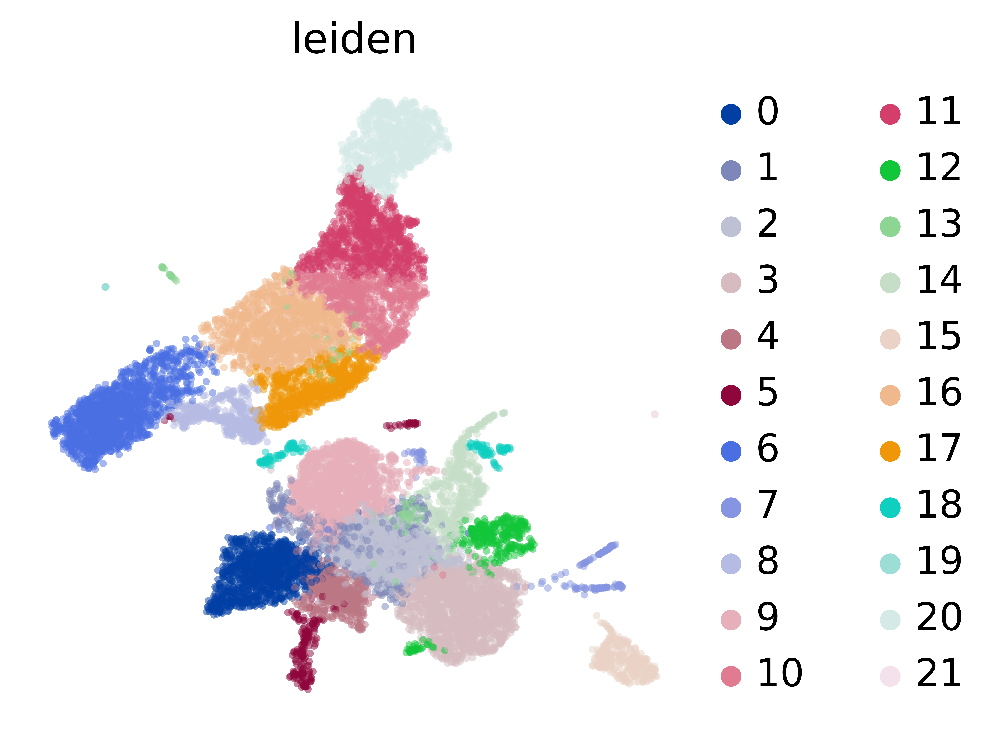

/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes

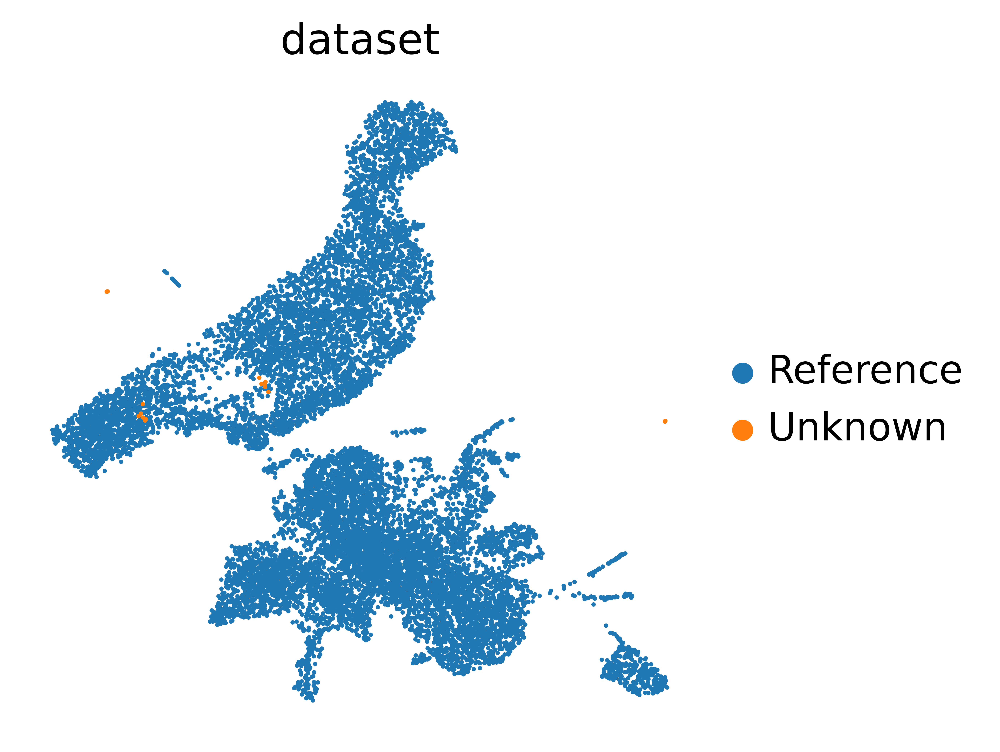

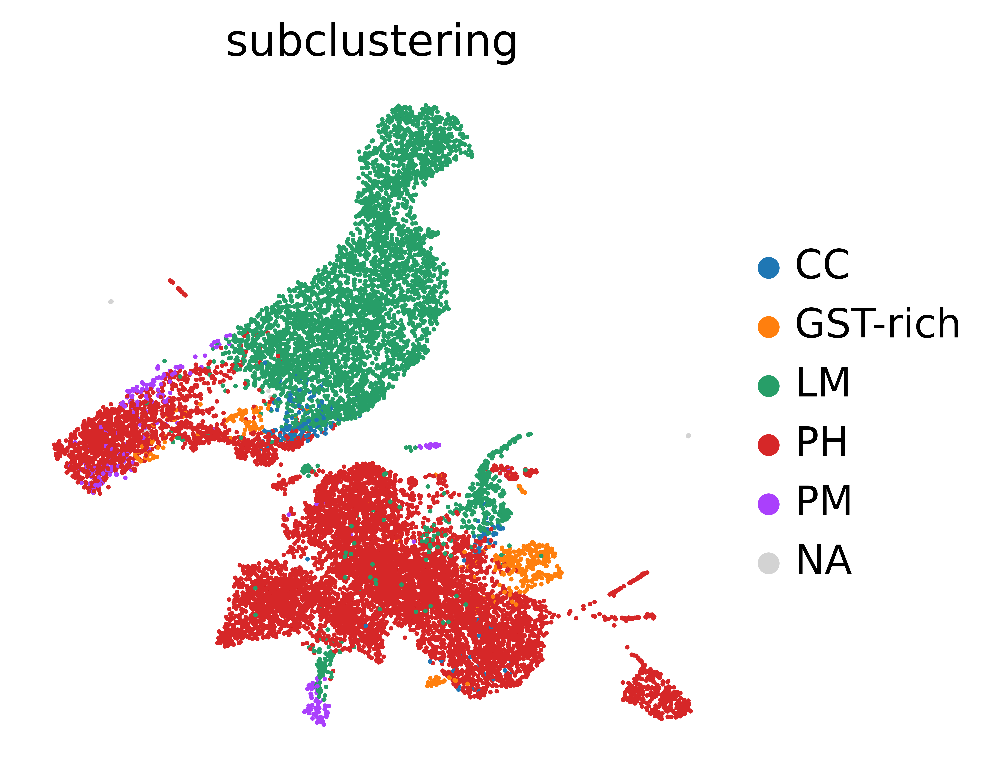

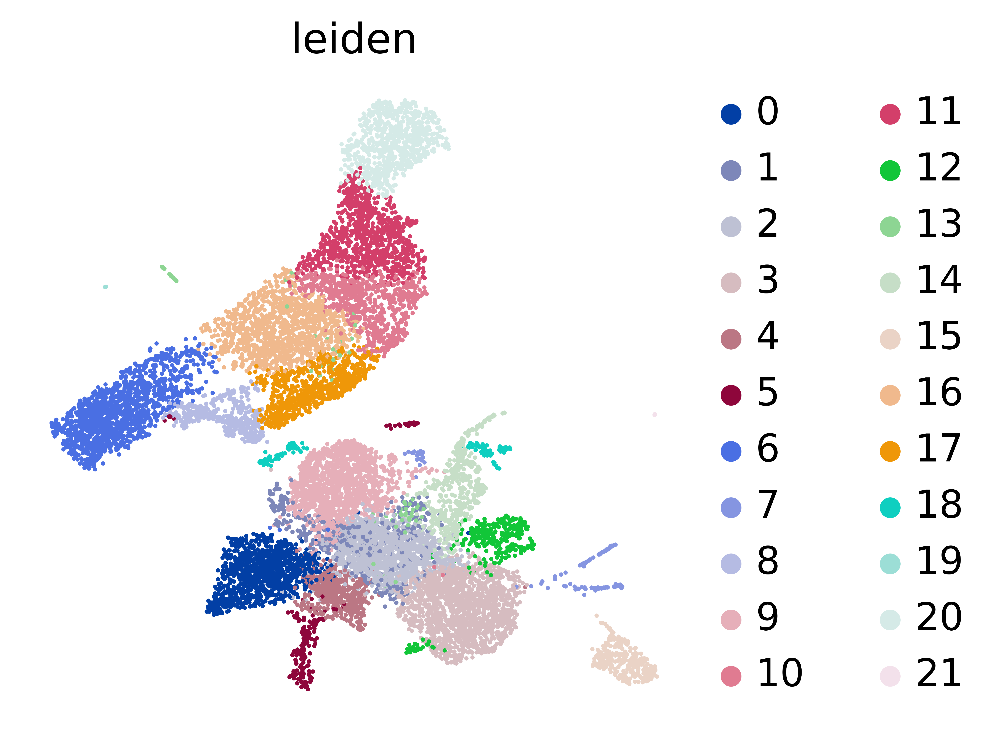

/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes_groups.py:461: RuntimeWarning: invalid value encountered in log2
  self.stats[group_name, "logfoldchanges"] = np.log2(
/private/home/jomojaco/mambaforge/envs/scanpy_ipynb/lib/python3.9/site-packages/scanpy/tools/_rank_genes

In [5]:

num_ref_cells = ref_adata.shape[0]
min_class_size = ref_adata.obs[annotation].value_counts().min()

k = int(np.sqrt(num_ref_cells))

# Run classification
print("Running kNN classification...")
results_df = kNN_classifier_with_stats(combined_adata, ref_label_key=annotation, k=k)

# Save results
output_path = os.path.join(output_folder, "annotated_cells.csv")
results_df.to_csv(output_path, index=False)
print(f"Results saved to {output_path}")

# Save annotated AnnData object
combined_adata.write_h5ad(os.path.join(output_folder, "annotated_adata.h5ad"))
print("Annotated dataset saved.")

# Plot UMAP and save the figures
plot_UMAP(combined_adata, annotation)

In [6]:


def kNN_classifier_with_stats(combined_adata, ref_label_key="cell_type", k=20):
    """
    Classifies unknown cells based on their k nearest neighbors in the reference dataset.
    Reports neighbor indices, distances, cell type assignments, and a z-score.
    
    Parameters:
    - combined_adata: AnnData object containing both reference and unknown cells.
    - ref_label_key: Column in `obs` that contains reference cell types.
    - k: Number of nearest neighbors to consider.

    Returns:
    - DataFrame with predicted labels, nearest neighbors, distances, and z-scores.
    """

    print("Performing kNN-based classification...")

    # Identify reference and unknown cell indices
    ref_indices = combined_adata.obs['dataset'] == 'Reference'
    unknown_indices = combined_adata.obs['dataset'] == 'Unknown'

    # Extract gene expression space (full gene expression matrix)
    X_ref = combined_adata[ref_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[ref_indices].X
    X_unknown = combined_adata[unknown_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[unknown_indices].X

    # Construct k-d tree for efficient neighbor searching
    tree = cKDTree(X_ref)

    # Find k nearest neighbors
    distances, indices = tree.query(X_unknown, k=k)

    # Retrieve reference cell labels
    ref_labels = combined_adata.obs.loc[ref_indices, ref_label_key].values

    # Initialize results
    results = []

    # Iterate over each unknown cell
    for i, (dists, neighbor_indices) in enumerate(zip(distances, indices)):
        # Get the cell type labels of the neighbors
        neighbor_labels = ref_labels[neighbor_indices]
        
        # Majority vote: assign the most frequent label
        assigned_label = pd.Series(neighbor_labels).mode()[0]
        
        # Compute a z-score for how well this cell matches the assigned label
        cell_type_counts = pd.Series(neighbor_labels).value_counts()
        expected_prob = cell_type_counts / k
        observed_prob = expected_prob.loc[assigned_label]
        z_score = (observed_prob - expected_prob.mean()) / expected_prob.std()

        # Store results
        results.append({
            "Unknown_Cell": combined_adata.obs.index[unknown_indices][i],
            "Predicted_Label": assigned_label,
            "Neighbor_Cells": list(combined_adata.obs.index[ref_indices][neighbor_indices]),
            "Neighbor_Types": list(neighbor_labels),
            "Distances": list(dists),
            "Z-score": z_score
        })

    # Convert results to a DataFrame
    results_df = pd.DataFrame(results)

    return results_df

def compute_p_value(neighbor_labels, assigned_label, k=20, num_permutations=1000):
    """
    Compute a p-value by shuffling labels and checking how often
    the assigned label appears by chance.
    """
    simulated_counts = []
    
    for _ in range(num_permutations):
        shuffled_labels = np.random.permutation(neighbor_labels)
        simulated_counts.append((shuffled_labels == assigned_label).sum() / k)

    observed_prob = (np.array(neighbor_labels) == assigned_label).sum() / k
    p_value = (100 - percentileofscore(simulated_counts, observed_prob)) / 100

    return p_value

In [7]:

results_df = kNN_classifier_with_stats(combined_adata, ref_label_key=annotation, k=k)

Performing kNN-based classification...


In [8]:
results_df

,Unknown_Cell,Predicted_Label,Neighbor_Cells,Neighbor_Types,Distances,Z-score
0,JW18DOX221117-1,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.48571007658583, 26.262904928146973, 26.412...",1.788623
1,JW18DOX221117-2,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.48225632018533, 26.264563708823566, 26.411...",1.788623
2,JW18DOX221117-3,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.551943077800974, 26.347796870675126, 26.48...",1.788623
3,JW18DOX221117-4,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.60524628218105, 26.411300909467837, 26.545...",1.788623
4,JW18DOX221117-5,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.515529064110105, 26.32563212925475, 26.463...",1.788623
5,JW18DOX221117-6,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCTGAATCCTAG-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.41695900770664, 26.176417345277404, 26.326...",1.788623
6,JW18wMel221117-1,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCGCCACGATGC-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.721305458709658, 26.180167729699654, 26.36...",1.788623
7,JW18wMel221117-2,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCGCCACGATGC-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.551401944493314, 25.961932493379376, 26.16...",1.788623
8,JW18wMel221117-3,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCGCCACGATGC-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.853233134593875, 26.342919285957045, 26.47...",1.788623
9,JW18wMel221117-4,PH,"[AAGAAAGCTACG-PI24CIRC-2, CCGCCACGATGC-PI24CIR...","[PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, PH, P...","[25.615395551644678, 26.088704006546, 26.23140...",1.788623


In [ ]:

# def load_and_merge_datasets(ref_path, unknown_path):
#     """
#     Load and merge reference and unknown datasets, ensuring gene alignment.
    
#     Parameters:
#     - ref_path: Path to the reference AnnData (.h5ad) file
#     - unknown_path: Path to the unknown AnnData (.h5ad) file
    
#     Returns:
#     - Combined AnnData object with batch information
#     """
    
#     # Load reference and unknown data
#     ref_adata = sc.read_h5ad(ref_path)
#     unknown_adata = sc.read_h5ad(unknown_path)

#     # Ensure the same genes are used (intersection to be safe)
#     common_genes = ref_adata.var_names.intersection(unknown_adata.var_names)
#     ref_adata = ref_adata[:, common_genes]
#     unknown_adata = unknown_adata[:, common_genes]

#     # Add dataset labels
#     ref_adata.obs['dataset'] = 'Reference'
#     unknown_adata.obs['dataset'] = 'Unknown'

#     # Concatenate datasets without PCA/UMAP
#     combined_adata = ad.concat([ref_adata, unknown_adata], join="outer", merge="first")

#     return combined_adata


# def normalize_with_mnn(combined_adata):
#     """
#     Apply Mutual Nearest Neighbors (MNN) batch correction to an AnnData object.
    
#     Parameters:
#     - combined_adata: AnnData object with batch information in 'dataset'
    
#     Returns:
#     - MNN batch-corrected AnnData object
#     """
#     sc.pp.normalize_total(combined_adata, target_sum=1e4)
#     sc.pp.log1p(combined_adata)
    
#     # Run MNN batch correction
#     sce.pp.mnn_correct(combined_adata, batch_key='dataset')

#     return combined_adata


# def kNN_classifier_with_stats(combined_adata, ref_label_key="cell_type", k=20):
#     """
#     Classifies unknown cells based on their k nearest neighbors in the reference dataset.
#     Reports neighbor indices, distances, cell type assignments, and a z-score.
    
#     Parameters:
#     - combined_adata: AnnData object containing both reference and unknown cells.
#     - ref_label_key: Column in `obs` that contains reference cell types.
#     - k: Number of nearest neighbors to consider.

#     Returns:
#     - DataFrame with predicted labels, nearest neighbors, distances, and z-scores.
#     """

#     print("Performing kNN-based classification...")

#     # Identify reference and unknown cell indices
#     ref_indices = combined_adata.obs['dataset'] == 'Reference'
#     unknown_indices = combined_adata.obs['dataset'] == 'Unknown'

#     # Extract gene expression space (full gene expression matrix)
#     X_ref = combined_adata[ref_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[ref_indices].X
#     X_unknown = combined_adata[unknown_indices].X.toarray() if hasattr(combined_adata.X, "toarray") else combined_adata[unknown_indices].X

#     # Construct k-d tree for efficient neighbor searching
#     tree = cKDTree(X_ref)

#     # Find k nearest neighbors
#     distances, indices = tree.query(X_unknown, k=k)

#     # Retrieve reference cell labels
#     ref_labels = combined_adata.obs.loc[ref_indices, ref_label_key].values

#     # Initialize results
#     results = []

#     # Iterate over each unknown cell
#     for i, (dists, neighbor_indices) in enumerate(zip(distances, indices)):
#         # Get the cell type labels of the neighbors
#         neighbor_labels = ref_labels[neighbor_indices]
        
#         # Majority vote: assign the most frequent label
#         assigned_label = pd.Series(neighbor_labels).mode()[0]
        
#         # Compute a z-score for how well this cell matches the assigned label
#         cell_type_counts = pd.Series(neighbor_labels).value_counts()
#         expected_prob = cell_type_counts / k
#         observed_prob = expected_prob.loc[assigned_label]
#         z_score = (observed_prob - expected_prob.mean()) / expected_prob.std()

#         # Store results
#         results.append({
#             "Unknown_Cell": combined_adata.obs.index[unknown_indices][i],
#             "Predicted_Label": assigned_label,
#             "Neighbor_Cells": list(combined_adata.obs.index[ref_indices][neighbor_indices]),
#             "Neighbor_Types": list(neighbor_labels),
#             "Distances": list(dists),
#             "Z-score": z_score
#         })

#     # Convert results to a DataFrame
#     results_df = pd.DataFrame(results)

#     return results_df

# def compute_p_value(neighbor_labels, assigned_label, k=20, num_permutations=1000):
#     """
#     Compute a p-value by shuffling labels and checking how often
#     the assigned label appears by chance.
#     """
#     simulated_counts = []
    
#     for _ in range(num_permutations):
#         shuffled_labels = np.random.permutation(neighbor_labels)
#         simulated_counts.append((shuffled_labels == assigned_label).sum() / k)

#     observed_prob = (np.array(neighbor_labels) == assigned_label).sum() / k
#     p_value = (100 - percentileofscore(simulated_counts, observed_prob)) / 100

#     return p_value
